In [ ]:
from IPython.display import HTML, display
import matplotlib.animation as animation
import matplotlib.pyplot as plt
import umap.umap_ as umap
import tensorflow as tf
import pandas as pd
import numpy as np

plt.rcParams.update({
    "text.usetex": True,
    "font.family": "serif",
    "animation.embed_limit": 100
})

tf.keras.backend.clear_session()
tf.config.set_visible_devices([], 'GPU')

metadata_cols = [
    "sgscore1", "distpsnr1", "sgscore2", "distpsnr2",
    "fwhm", "magpsf", "sigmapsf", "chipsf", "ra",
    "dec", "diffmaglim", "ndethist", "nmtchps", "age",
    "days_since_peak", "days_to_peak", "peakmag_so_far",
    "new_drb", "ncovhist", "nnotdet", "chinr", "sharpnr",
    "scorr", "sky", "maxmag_so_far"
]

In [16]:
def get_embedding(model_path,
                  cand_path, trips_path=None,
                  layer_idx=-3, metadata_cols=None,
                  umap_seed=2):
    need_triplets = trips_path is not None
    need_metadata = metadata_cols is not None
    
    model = tf.keras.models.load_model(model_path)
    emb_model = tf.keras.Model(
        inputs=model.input,
        outputs=model.get_layer(model.layers[layer_idx].name).output
    )
    
    cand = pd.read_csv(cand_path, index_col=None)
    if need_triplets:
        triplets = np.load(trips_path, mmap_mode='r')

    if need_triplets and need_metadata:
        embeddings = emb_model.predict(
            [triplets, cand.loc[:, metadata_cols]],
            batch_size=512, verbose=1
        )
        
        raw_preds = model.predict(
            [triplets, cand.loc[:, metadata_cols]],
            batch_size=512, verbose=1
        )
    elif need_triplets:
        embeddings = emb_model.predict(
            triplets, batch_size=512, verbose=1
        )
        
        raw_preds = model.predict(
            triplets, batch_size=512, verbose=1
        )
    elif need_metadata:
        embeddings = emb_model.predict(
            cand.loc[:, metadata_cols],
            batch_size=512, verbose=1
        )
        
        raw_preds = model.predict(
            cand.loc[:, metadata_cols],
            batch_size=512, verbose=1
        )   
    
    preds = np.rint(np.transpose(raw_preds))[0].astype(int)
    results = preds == cand["label"].to_numpy()
    print(f"Overall test accuracy {100*np.sum(results) / len(results):.2f}%")

    umap_model = umap.UMAP(random_state=umap_seed)
    umap_emb = umap_model.fit_transform(embeddings)

    cand['raw_preds'] = raw_preds
    cand["umap_emb_1"] = umap_emb[:, 0]
    cand["umap_emb_2"] = umap_emb[:, 1]

    return cand

In [17]:
mm_cand = get_embedding(
    model_path="../production_models/best_model",
    cand_path="../data/v10/test_cand_v10_N100.csv",
    trips_path="../data/v10/test_triplets_v10_N100.npy",
    metadata_cols=metadata_cols
)

cnn_cand = get_embedding(
    model_path="../models/um_cnn_v10_N100/effortless-butterfly-905/best_model/",
    cand_path="../data/v10/test_cand_v10_N100.csv",
    trips_path="../data/v10/test_triplets_v10_N100.npy",
)

mdata_cand = get_embedding(
    model_path="../models/um_nn_v10_N30/swept-deluge-897/best_model/",
    cand_path="../data/v10/test_cand_v10_N30.csv",
    metadata_cols=metadata_cols
)


152/152 [==============================] - 98s 641ms/step
Overall test accuracy 94.87%


/Users/nabeelr/miniforge3/envs/BTSbot/lib/python3.10/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


152/152 [==============================] - 60s 396ms/step
Overall test accuracy 82.42%


/Users/nabeelr/miniforge3/envs/BTSbot/lib/python3.10/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


146/146 [==============================] - 0s 513us/step
Overall test accuracy 95.47%


/Users/nabeelr/miniforge3/envs/BTSbot/lib/python3.10/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


(74394, 2)

In [28]:
def plot_umap_embedding(
    cand, color_col=None, colormap='viridis', s=5, alpha=1.0,
    figsize=(10, 8), title=None, colorbar_label=False, ax=None
):
    if ax is None:
        fig, ax = plt.figure(figsize=figsize), plt.gca()
    
    embedding = cand[['umap_emb_1', 'umap_emb_2']].to_numpy()
    
    # If labels are provided, use them for coloring
    if color_col is not None:
        if color_col == "source_set":
            source_set_unique = cand["source_set"].unique()
            source_set_map = {label: i for i, label in enumerate(source_set_unique)}
            color_col_values = cand["source_set"].map(source_set_map)
        else:
            color_col_values = cand[color_col]
        
        scatter = ax.scatter(embedding[:, 0], embedding[:, 1],
                             c=color_col_values, cmap=colormap, s=s, alpha=alpha)
        if colorbar_label:
            cbar = plt.colorbar(scatter, ax=ax)
            if isinstance(colorbar_label, bool):
                colorbar_label_str = color_col
            else:
                colorbar_label_str = colorbar_label
            cbar.set_label(colorbar_label_str)
            
            if color_col == "source_set" and ax.collections:
                scatter_plot = ax.collections[0]
                # Check if the scatter plot has an associated colorbar
                if hasattr(scatter_plot, 'colorbar') and scatter_plot.colorbar is not None:
                    cb = scatter_plot.colorbar
                    
                    # Set the ticks to be the integer values 0, 1, ..., n_unique_labels-1
                    ticks = np.arange(len(source_set_unique))
                    cb.set_ticks(ticks)
                    
                    # Set the tick labels to be the original string values
                    cb.set_ticklabels(source_set_unique)
    else:
        ax.scatter(embedding[:, 0], embedding[:, 1], s=s, alpha=alpha)
    
    ax.set_xlabel('UMAP_1')
    ax.set_ylabel('UMAP_2')
    
    if title:
        ax.set_title(title)
    
    return ax

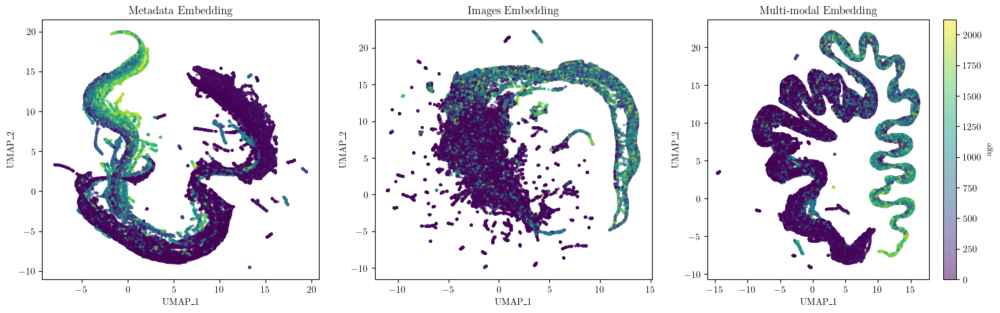

In [41]:
fig = plt.figure(figsize=(18, 5))
gs = fig.add_gridspec(1, 3)
ax1 = fig.add_subplot(gs[0])
ax2 = fig.add_subplot(gs[1])
ax3 = fig.add_subplot(gs[2])

color_col = "age"

# Call plot_umap_embedding and capture the returned figure and axes
ax1.set_title("Metadata Embedding")
ax1 = plot_umap_embedding(
    mdata_cand, 
    color_col=color_col, 
    alpha=0.5, s=4, colormap='viridis', 
    ax=ax1
)

ax2.set_title("Images Embedding")
ax2 = plot_umap_embedding(
    cnn_cand, 
    color_col=color_col,
    alpha=0.5, s=4, colormap='viridis', 
    ax=ax2
)

ax3.set_title("Multi-modal Embedding")
ax3 = plot_umap_embedding(
    mm_cand, 
    color_col=color_col,
    alpha=0.5, s=4, colormap='viridis', 
    colorbar_label=True, 
    ax=ax3
)

# plt.savefig("BTSbot_latent_spaces.png", dpi=300, bbox_inches='tight')
plt.show()


In [66]:
def animate_embedding_evolution(cand, objectId=None):
    if objectId is None:
        # Select one random objectId
        unique_object_ids = cand.loc[cand['label'] == 1]['objectId'].unique()
        objectId = np.random.choice(unique_object_ids)
        print(f"Selected objectId: {objectId}")

    # Filter data for the selected objectId and sort by jd
    object_data = cand[cand['objectId'] == objectId].copy()
    object_data.sort_values('jd', inplace=True)

    fig, ax = plt.subplots(figsize=(10, 8))
    plt.tight_layout()

    emb1 = cand['umap_emb_1']
    emb2 = cand['umap_emb_2']

    obj_emb1 = object_data['umap_emb_1']
    obj_emb2 = object_data['umap_emb_2']

    # --- Background scatter plot ---
    # Create a mapping from unique source_set strings to integers for coloring
    unique_source_sets = cand['source_set'].unique()
    source_set_map = {source: i for i, source in enumerate(unique_source_sets)}
    colors_for_background = cand['source_set'].map(source_set_map)

    cmap_bg = 'viridis'
    background_scatter = ax.scatter(
        emb1, emb2, c=colors_for_background,
        cmap=cmap_bg, s=10, alpha=0.3,
        label='All other objects'
    )
    # --- End of background scatter plot ---

    # Set plot limits based on the overall embedding range
    ax.set_xlim(emb1.min() - 1, emb1.max() + 1)
    ax.set_ylim(emb2.min() - 1, emb2.max() + 1)
    ax.set_title(f'Movement of object {objectId} in embedding space')

    # Animated point (foreground)
    animated_point_scatter = ax.scatter([], [], s=450, c='gold', marker='*', zorder=5,
                                        edgecolors='black', label=f'Object {objectId}') # Emphasize animated point
    trail, = ax.plot([], [], 'o-', alpha=0.7, linewidth=4, zorder=4) # Line for the trail
    current_text = ax.text(0.02, 0.9, '', transform=ax.transAxes, fontsize=12)

    # Add a legend for background points if cmap is 'tab10' or similar categorical
    if cmap_bg.startswith('tab'): # Heuristic for categorical colormaps
        handles, labels = background_scatter.legend_elements(prop="colors", alpha=0.6)
        # Create proxy artists for the legend if needed, or directly use handles if they are appropriate
        legend_handles = [plt.Line2D([0], [0], marker='o', color='w', label=unique_source_sets[i],
                          markersize=10) for i, handle in enumerate(handles)]
        ax.legend(handles=legend_handles, title="Source Sets (Background)", bbox_to_anchor=(1.05, 1), loc='upper left')

    def init():
        animated_point_scatter.set_offsets(np.empty((0, 2)))
        trail.set_data([], [])
        current_text.set_text('')
        return animated_point_scatter, trail, current_text

    def animate(i):
        animated_point_scatter.set_offsets(np.c_[obj_emb1.iloc[i], obj_emb2.iloc[i]])
        trail.set_data(obj_emb1.iloc[:i+1], obj_emb2.iloc[:i+1])
        current_text.set_text(
            f'Source Set: {object_data["source_set"].iloc[i]}\n'
            f'JD: {object_data["jd"].iloc[i]:.2f}\n'
            f'Magnitude: {object_data["magpsf"].iloc[i]:.2f}\n'
            f'Age: {object_data["age"].iloc[i]:.5f}'
        )
        return animated_point_scatter, trail, current_text

    if not object_data.empty:
        anim = animation.FuncAnimation(fig, animate, init_func=init, frames=len(object_data), interval=200, blit=True)
        display(HTML(anim.to_jshtml()))
    else:
        print(f"No data found for objectId: {objectId}")
    
    plt.close(fig) # Keep this commented out for now to see the final static plot with legend

In [67]:
animate_embedding_evolution(mm_cand)

Selected objectId: ZTF20abyzgzj


In [55]:
mm_cand.loc[mm_cand['objectId'] == "ZTF23aaixdcm"]

,objectId,jd,label,fid,diffmaglim,programid,candid,isdiffpos,field,ra,...,days_to_peak,nnotdet,source_set,N,split,is_SN,near_threshold,is_rise,umap_emb_1,umap_emb_2
333,ZTF23aaixdcm,2.460114e+06,1,1,20.819988,1,2359424674115015002,True,596,330.966940,...,14.040521,2481,trues,37,test,True,False,False,4.760817,-8.436201
1613,ZTF23aaixdcm,2.460161e+06,1,2,19.880245,2,2406440004115015000,True,596,330.966928,...,14.040521,2491,trues,34,test,True,False,False,6.527669,-8.399176
1787,ZTF23aaixdcm,2.460155e+06,1,1,20.088953,2,2400465234115015078,True,596,330.966931,...,14.040521,2485,trues,71,test,True,False,False,6.952398,-8.168736
2397,ZTF23aaixdcm,2.460137e+06,1,2,20.653797,2,2382428914115015003,True,596,330.966937,...,14.040521,2481,trues,98,test,True,False,False,4.906749,-8.474607
2467,ZTF23aaixdcm,2.460153e+06,1,1,20.558104,1,2398456664115015004,True,596,330.966931,...,14.040521,2483,trues,85,test,True,False,False,7.410323,-7.702987
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
76855,ZTF23aaixdcm,2.460143e+06,1,2,20.549908,2,2388458404115015019,True,596,330.966931,...,14.040521,2483,trues,57,test,True,False,False,4.957628,-8.485190
76894,ZTF23aaixdcm,2.460122e+06,1,2,20.449430,1,2367443264115015005,True,596,330.966946,...,14.040521,2481,trues,26,test,True,False,False,4.239830,-7.818310
77033,ZTF23aaixdcm,2.460152e+06,1,2,20.738350,2,2397400064115015003,True,596,330.966944,...,14.040521,2483,trues,77,test,True,False,False,6.676103,-8.295017
77145,ZTF23aaixdcm,2.460170e+06,1,2,20.629553,2,2415332144115015002,True,596,330.966942,...,14.040521,2491,trues,32,test,True,False,False,7.335487,-7.839224
